# Повышение разрешения изображений с помощью автокодировщиков с глубокими сверточными сетями

- Базовый сверточный автокодировщик (CAE)
- Вариационный автокодировщик (VAE)
- Super-Resolution Comvolutional Neural Network (SRCNN)
- ESPCN (Efficient Sub-Pixel Convolutional Network)
- FSRCNN (Fast Super-Resolution Convolutional Neural Network)
- SRGAN
- ESRGAN

In [60]:
# Работа с массивами данных
import numpy as np

import keras
# Графики
import matplotlib.pyplot as plt
%matplotlib inline

# Конструктор модели
from keras.models import Model

# Утилиты
from keras import utils

# Слои
from keras.layers import Conv2D, MaxPooling2D, Dense, Input, UpSampling2D, Conv2DTranspose, BatchNormalization, LeakyReLU

# Оптимизатор
from keras.optimizers import Adam

# Коллбэки
from keras.callbacks import EarlyStopping

# Opencv для работы с изображениями
import cv2

# Системный команды
import os

# Аугментация
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf

# Расщипление выборок
from sklearn.model_selection import train_test_split

# Случайный выбор
import random

import requests
import tensorflow_datasets as tfds
from tqdm import tqdm
import shutil

In [2]:
# Задаем пути к папкам
train_path = './dataset/train' # тренировочные образцы
val_path = './dataset/val' # контрольные образцы

In [3]:
train_path_hr = os.path.join(train_path, 'high_res')
train_path_lr = os.path.join(train_path, 'low_res')
val_path_hr = os.path.join(val_path, 'high_res')
val_path_lr = os.path.join(val_path, 'low_res')

In [4]:
train_high_res = [] # список файлов без водяных знаков (тренировочная выборка)
train_low_res = []  # список файлов с водяными знаков (тренировочная выборка)
valid_high_res = [] # список файлов без водяных знаков (контрольная выборка)
valid_low_res = [] # список файлов с водяными знаков (контрольная выборка)

# # Обнаружено в датасете не соответствие, просто удалим файл
# try:
#     os.remove('./watermarked/wm-nowm/train/watermark/animal-dog-pet-cute.jpg')
# except Exception as e:
#     print(e) # вывод ошибки загрузки или масштабирования картинки

# Найдем парные файлы для тренировочной выборки
for file_hr in sorted(os.listdir(train_path_hr)):
    for file_lr in sorted(os.listdir(train_path_lr)):
        # Если имена файлов в обеих папках совпадают, то добавляем пути к этим файлам в списки
        if file_hr == file_lr:
            train_high_res.append(os.path.join(train_path_hr, file_hr))
            train_low_res.append(os.path.join(train_path_lr, file_lr))

# Найдем парные файлы для контрольной выборки
for file_hr in sorted(os.listdir(val_path_hr)):
    for file_lr in sorted(os.listdir(val_path_lr)):
        # Если имена файлов в обеих папках совпадают, то добавляем пути к этим файлам в списки
        if file_hr == file_lr:
            valid_high_res.append(os.path.join(val_path_hr, file_hr))
            valid_low_res.append(os.path.join(val_path_lr, file_lr))

In [5]:
print('Обучающая выборка содержит:')
print(len(train_high_res), 'Файлов в высоком разрешении')
print(len(train_low_res), 'Файлов в низком разрешении')

Обучающая выборка содержит:
685 Файлов в высоком разрешении
685 Файлов в низком разрешении


In [6]:
print('Контрольная выборка содержит:')
print(len(valid_high_res), 'Файлов в высоком разрешении')
print(len(valid_low_res), 'Файлов в низком разрешении')

Контрольная выборка содержит:
170 Файлов в высоком разрешении
170 Файлов в низком разрешении


In [7]:
# Размер преобразованных картинок
width = 256
height = 256
dim = (width, height)

# Функция загрузки и масштабирования картинок
def createPixelArr(files):
    data = []
    for image in files: # цикл по каждой картинке в списке
        try:
            # Загрузим изображение в матрицу (сохранив цвета, загружает как BGR)
            img_arr = cv2.imread(image, cv2.IMREAD_COLOR)
            resized_arr = cv2.resize(img_arr, (width, height)) # масштабируем изображение
            data.append(resized_arr) # добавляем в список матрицу пикселей картинки
        except Exception as e:
            print(e) # вывод ошибки загрузки или масштабирования картинки
    return np.array(data) # возвращаем набор картинок как матрицу

In [8]:
y_train = createPixelArr(train_high_res) # подготовка картинок (без знаков, обучающая выборка)
X_train = createPixelArr(train_low_res)    # подготовка картинок (водяные знаки, обучающая выборка)

y_test = createPixelArr(valid_high_res)  # подготовка картинок (без знаков, контрольная выборка)
X_test = createPixelArr(valid_low_res)     # подготовка картинок (водяные знаки, контрольная выборка)

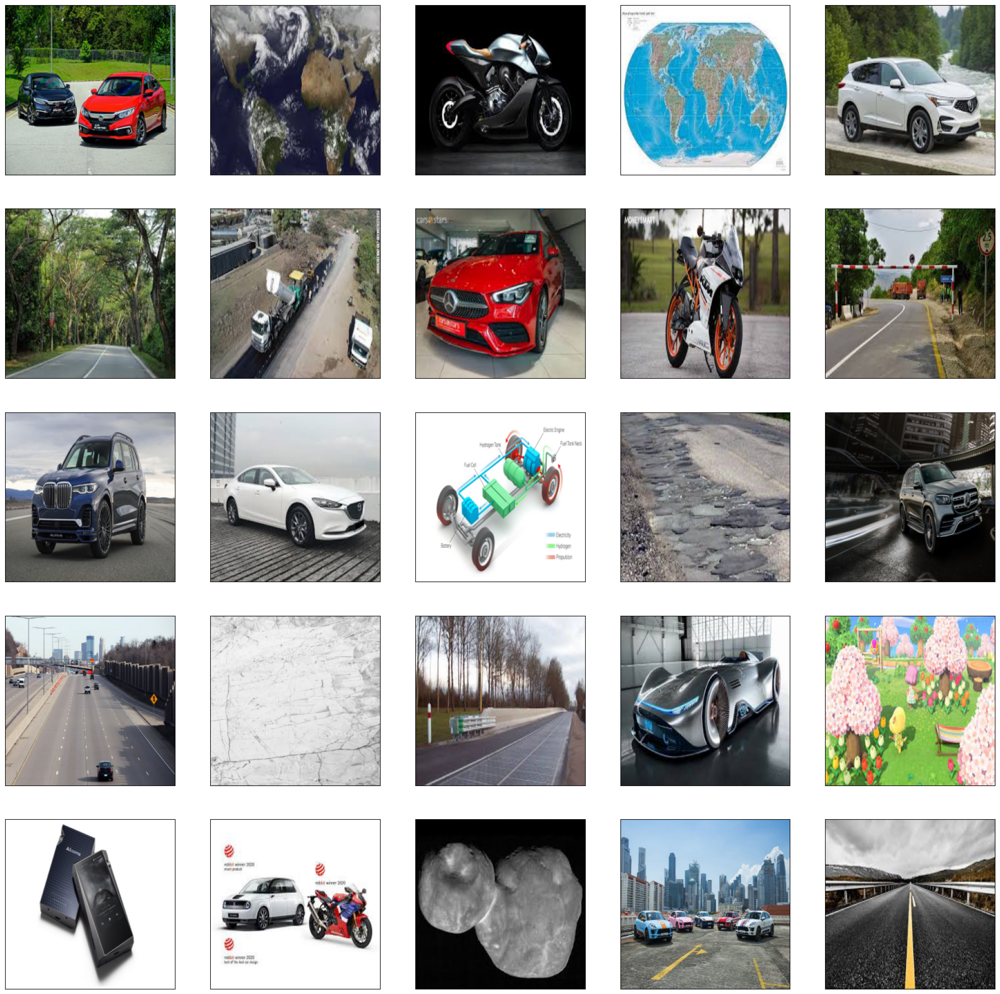

In [9]:
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # Преобразуем картинку в формат RGB перед выводом
    plt.imshow(cv2.cvtColor(y_train[i], cv2.COLOR_BGR2RGB))
plt.show()

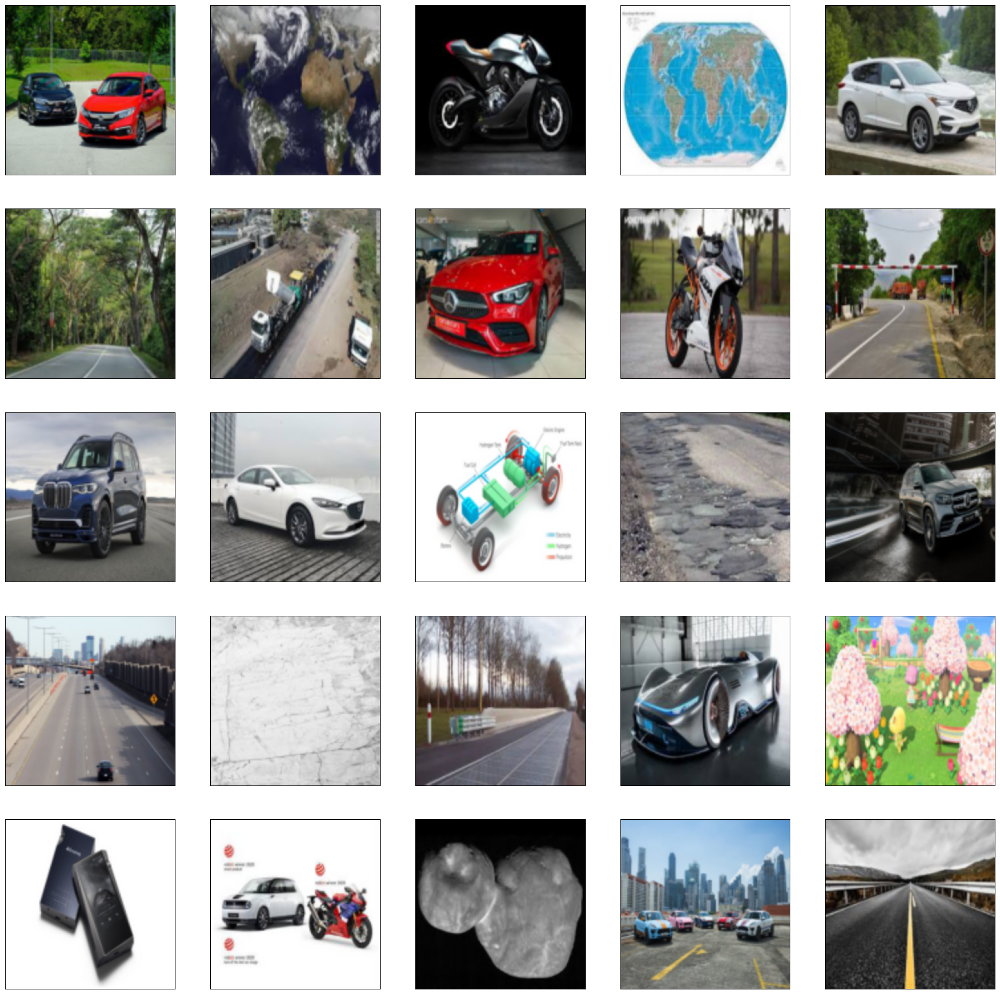

In [10]:
plt.figure(figsize=(25, 25))
for i in range(25):
    plt.subplot(5, 5, i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    # Преобразуем картинку в формат RGB перед выводом
    plt.imshow(cv2.cvtColor(X_train[i], cv2.COLOR_BGR2RGB))
plt.show()

In [11]:
train_nonwatermarked = None
train_watermarked    = None
valid_nonwatermarked = None
valid_watermarked    = None

In [12]:
# Функции аугментации изображений

def data_augmentation(inputImage): # функция прогоняет картинки через все методы аугментации
    return randomContrast(randomBrightness(inputImage)).numpy()


def randomBrightness(pic): # добавляем изображению случайную яркость от 1% до 20%
    return tf.image.random_brightness(pic, random.uniform(0.01, 0.2), 1)

def randomContrast(pic): # добавляем изображению случайную контрастность от 5% до 50%
    return tf.image.random_contrast(pic, 0.2, 0.7, 1)

In [13]:
data_augmented_X = []
data_augmented_y = []

for image in X_train:
    data_augmented_X.append(data_augmentation(image))

for image in y_train:
    data_augmented_y.append(data_augmentation(image))

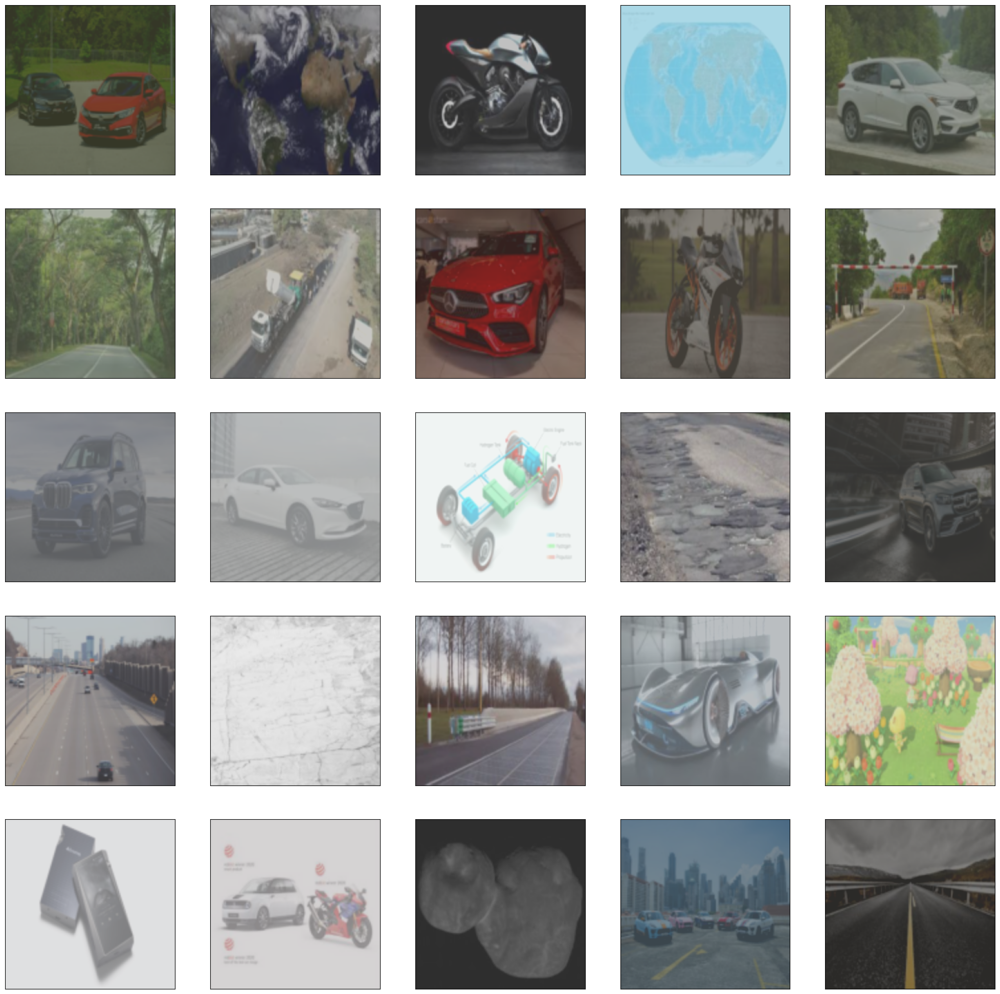

In [14]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_X[i], cv2.COLOR_BGR2RGB))
plt.show()

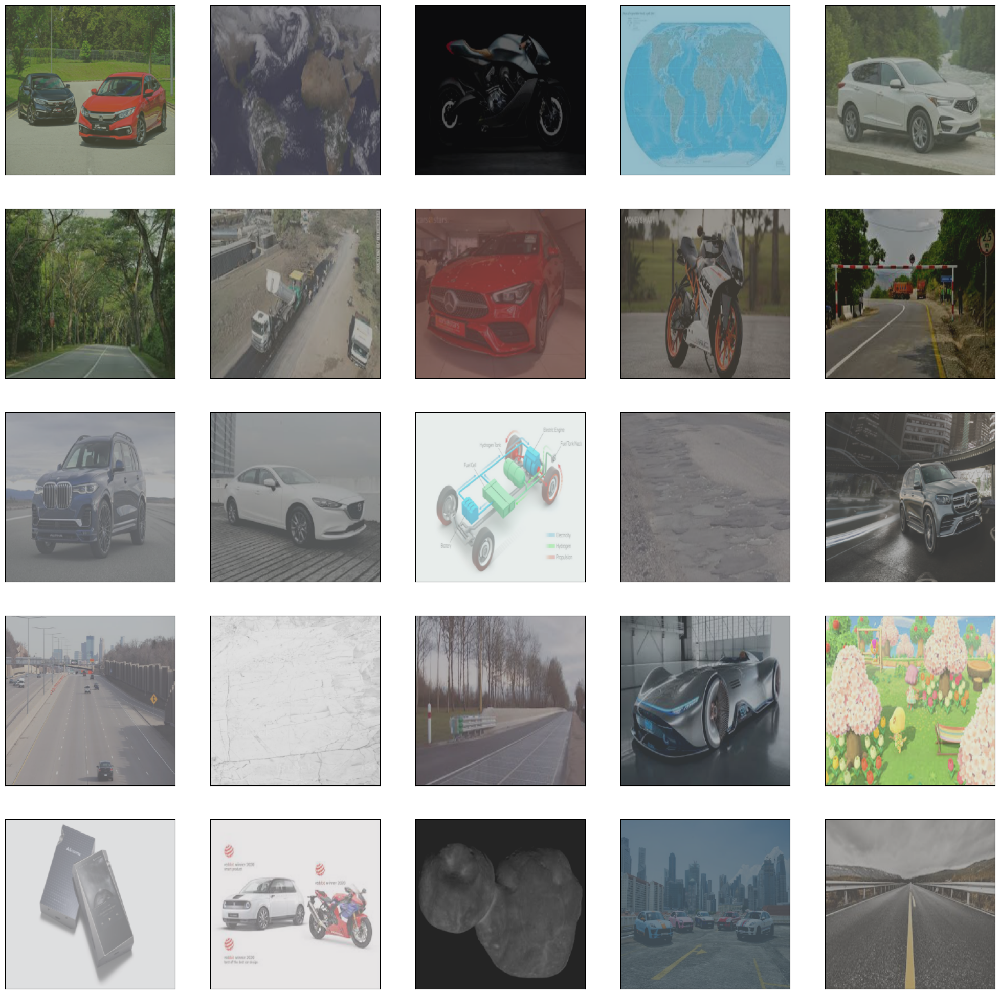

In [15]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data_augmented_y[i], cv2.COLOR_BGR2RGB))
plt.show()

In [16]:
X_train = np.append(X_train, data_augmented_X, axis=0)
y_train = np.append(y_train, data_augmented_y, axis=0)

In [17]:
X_train = X_train.astype('float32') / 255.
y_train = y_train.astype('float32') / 255.
X_test = X_test.astype('float32') / 255.
y_test = y_test.astype('float32') / 255.

## Реализация разных архитектур

### Convolutional Auto-encoder (CAE)

Классический автокодировщик, использующий сверточные слои.

In [61]:
def create_CAE(img_x, img_y, channel):
    inputs = Input(shape=(img_x, img_y, channel))

    # Кодировщик
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    x = Conv2D(48, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    # Убираем последний Pooling (оставляем больше информации)
    x = Conv2D(40, (3, 3), activation='relu', padding='same')(x)
    h = x  # Латентное представление

    # Декодировщик - Улучшаем восстановление
    x = Conv2D(40, (3, 3), activation='relu', padding='same')(h)

    x = Conv2D(48, (3, 3), activation='relu', padding='same')(x)  # Доп. слой
    x = UpSampling2D((2, 2))(x)
 
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)  # Доп. слой
    x = UpSampling2D((2, 2))(x)

    outputs = Conv2D(channel, (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(inputs, outputs)
    model.compile(optimizer=Adam(learning_rate=5e-5), loss='mse', metrics=['acc'])
    return model

### Super Resolution Generative Adversarial Network (SRGAN)

Процедура обучения:
- Обрабатываем изображения высокого разрешения, чтобы получить образцы низкого разрешения для нашего датасета
- Прогоняем изображения низкого разрешения через генератор, повышающий разрешение изображений
- Используем дискриминатора для распознавания изображения высокого разрешения и обратного распространения ошибки для обчения дискриминатора и генератора.

![image_1.png](attachment:image_1.png)

In [97]:
import os
import numpy as np
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import cv2
import matplotlib.pyplot as plt
import random
import torch.nn as nn
from torchvision.models import vgg19
import torch
from torch import optim
from tqdm.notebook import tqdm
import torchvision.transforms as transforms

In [98]:
# Define the transformations on the data
low_res_size = 128
high_res_size = 256

transform_low = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((low_res_size, low_res_size)),
    transforms.ToTensor(),
])

transform_high = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((high_res_size, high_res_size)),
    transforms.ToTensor(),
])

In [99]:
class ImageDataset(Dataset):
    # This is a custom dataset created using pytorch Dataset
    def __init__(self, root_dir):
        super(ImageDataset, self).__init__()
        self.data = []
        self.root_dir = root_dir
        files_low = os.listdir(os.path.join(root_dir, "low_res"))
        files_high = os.listdir(os.path.join(root_dir, "high_res"))
        self.data = list(zip(files_low, files_high))

        
    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        img_low_file, img_high_file = self.data[index]
        
        # Get the path for the image LR and HR
        low_res_pth = os.path.join(self.root_dir, "low_res", img_low_file)
        high_res_pth = os.path.join(self.root_dir, "high_res", img_high_file)

        # Open the actual image
        low_res = np.array(Image.open(low_res_pth))
        high_res = np.array(Image.open(high_res_pth))
        
        # Discarding the alpha channel to make the model more optimized for memory
        low_res = low_res[:, :, :3]
        high_res = high_res[:, :, :3]
        
        # Apply the transformation to the image
        low_res = transform_low(low_res)
        high_res = transform_high(high_res)
        
        return low_res, high_res

In [100]:
# Showing an image from the dataset
def show_image():
    dataset = ImageDataset(root_dir="./dataset/train")
    loader = DataLoader(dataset, batch_size=128, num_workers=0)
    # Create a figure with two subplots
    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    for idx, (low_res, high_res) in enumerate(loader):
        # Display the first image in the left subplot
        axs[0].imshow(low_res[0].permute(1, 2, 0))
        axs[0].set_title("low res")

        # Display the second image in the right subplot
        axs[1].imshow(high_res[0].permute(1, 2, 0))
        axs[1].set_title("high res")
        
        if(idx == 0):
            break
            
    # Show the figure
    plt.show() 

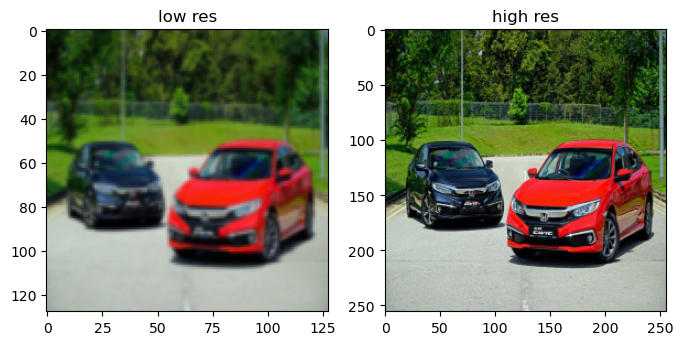

In [101]:
show_image()

In [102]:
device = "cuda" if torch.cuda.is_available() else "cpu"
lr = 3e-4
epochs = 30
batch_size = 16
num_workers = 0
img_channels = 3

In [76]:
!pip install pyopenssl ndg-httpsclient pyasn1 urllib3


In [77]:
# listing the model to take the required subset of it
test_vgg_model = vgg19(weights=True).eval().to(device)
lf = list(test_vgg_model.features)
lf[25]

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to C:\Users\Александр/.cache\torch\hub\checkpoints\vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [03:28<00:00, 2.75MB/s] 


Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))

In [103]:
class vggL(nn.Module):
    def __init__(self):
        super().__init__()
        self.vgg = vgg19(pretrained=True).features[:25].eval().to(device)
        self.loss = nn.MSELoss()

    def forward(self, first, second):
        vgg_first = self.vgg(first)
        vgg_second = self.vgg(second)
        perceptual_loss = self.loss(vgg_first, vgg_second)
        return perceptual_loss

In [105]:
class ConvBlock(nn.Module):
    # Conv -> BN -> leakyReLU
    def __init__(
            self,
            in_channels,
            out_channels,
            use_activation=True,
            use_BatchNorm=True,
            **kwargs
    ):
        
        super().__init__()
        self.use_activation = use_activation
        self.cnn = nn.Conv2d(in_channels, out_channels, **kwargs)
        self.bn = nn.BatchNorm2d(out_channels) if use_BatchNorm else nn.Identity()
        self.ac = (
            nn.LeakyReLU(0.2, inplace=True)
        )

    def forward(self, x):
        x1 = self.cnn(x)
        x2 = self.bn(x1)
        x3 = self.ac(x2)
        return x3 if self.use_activation else x2

In [106]:
class UpsampleBlock(nn.Module):
    def __init__(self, in_channels, scale_factor):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, in_channels * scale_factor ** 2, 2, 1, 1)
        self.ps = nn.PixelShuffle(scale_factor)
        self.ac = nn.PReLU(num_parameters=in_channels)

    def forward(self, x):
        return self.ac(self.ps(self.conv(x)))

In [107]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.b1 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1
        )

        self.b2 = ConvBlock(
            in_channels,
            in_channels,
            kernel_size=3,
            stride=1,
            padding=1,
            use_activation=False
        )

    def forward(self, x):
        out = self.b1(x)
        out = self.b2(out)
        return out + x

In [108]:
class Generator(nn.Module):
    def __init__(self, in_channels=3, num_channels=64, num_blocks=8):
        super().__init__()
        self.initial = ConvBlock(in_channels, num_channels, kernel_size=7, stride=1, padding=4, use_BatchNorm=False)
        self.res = nn.Sequential(*[ResidualBlock(num_channels) for i in range(num_blocks)])
        self.conv = ConvBlock(num_channels, num_channels, kernel_size=3, stride=1, padding=1, use_activation=False)
        self.up = nn.Sequential(UpsampleBlock(num_channels, scale_factor=2)) 
        self.final = nn.Conv2d(num_channels, in_channels, kernel_size=9, stride=1, padding=1)

    def forward(self, x):
        x = self.initial(x)
        c = self.res(x)
        c = self.conv(c) + x
        c = self.up(c)
        return torch.sigmoid(self.final(c))

In [109]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, features=[64, 64, 128, 128, 256, 256, 512, 512]):
        super().__init__()
        blocks = []
        for idx, feature in enumerate(features):
            blocks.append(
                ConvBlock(
                    in_channels,
                    feature,
                    kernel_size=3,
                    stride = idx % 2 + 1,
                    padding=1,
                    use_activation=True,
                    use_BatchNorm=idx != 0,
                )
            )
            in_channels = feature

        self.blocks = nn.Sequential(*blocks)

        self.mlp = nn.Sequential(
            nn.AdaptiveAvgPool2d((8, 8)),
            nn.Flatten(),
            nn.Linear(512*8*8, 1024),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(1024, 1)
        )

    def forward(self, x):
        x = self.blocks(x)
        x = self.mlp(x)
        return x

In [110]:
def plot_examples(gen):
    dataset_test = ImageDataset(root_dir="./dataset/val")
    loader = DataLoader(dataset_test, batch_size=16, num_workers=0)
    
    # Create a figure with two subplots
    fig, axs = plt.subplots(1, 3, figsize=(8, 4))
    chosen_batch = random.randint(0, len(loader)-1)
    for idx, (low_res, high_res) in enumerate(loader):
        if(chosen_batch == idx):
            chosen = random.randint(0, len(low_res)-1)
        
            axs[0].set_axis_off()
            axs[0].imshow(low_res[chosen].permute(1, 2, 0))
            axs[0].set_title("low res")

            with torch.no_grad():
                upscaled_img = gen(low_res[chosen].to(device).unsqueeze(0))
        
            axs[1].set_axis_off()
            axs[1].imshow(upscaled_img.cpu().permute(0, 2, 3, 1)[0])
            axs[1].set_title("predicted")
        
            axs[2].set_axis_off()
            axs[2].imshow(high_res[chosen].permute(1, 2, 0))
            axs[2].set_title("high res")
        
            if(idx == 1):
                break
            
    # Show the figure
    plt.show()      
    
    gen.train()

In [111]:
from IPython.display import clear_output
import matplotlib.pyplot as plt

def train_progress(epoch, num_epochs, d_losses, g_losses):
    clear_output(wait=True)
    plt.figure(figsize=(10,5))
    plt.title("Training progress")
    plt.plot(d_losses,label="Discriminator loss")
    plt.plot(g_losses,label="Generator loss")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

    print(f"Epoch [{epoch}/{num_epochs}], Discriminator loss: {d_losses[-1]:.4f}, Generator loss: {g_losses[-1]:.4f}")

In [112]:
# define the generator / discriminator / and other hyperparameters (not already defined above)
gen = Generator(in_channels=3).to(device)
disc = Discriminator(in_channels=3).to(device)
opt_gen = optim.Adam(gen.parameters(), lr=lr, betas=(0.9, 0.999))
opt_disc = optim.Adam(disc.parameters(), lr=lr, betas=(0.9, 0.999))
mse = nn.MSELoss()
bce = nn.BCEWithLogitsLoss()
vgg_loss = vggL()

In [113]:
# the data loaders for training and validation
train = ImageDataset(root_dir="./dataset/train")
train_loader = DataLoader(train, batch_size=batch_size, num_workers=num_workers)

val = ImageDataset(root_dir="./dataset/val")
val_loader = DataLoader(val, batch_size=batch_size, num_workers=num_workers)

In [114]:
def train_fn(loader, disc, gen, opt_gen, opt_disc, mse, bce, vgg_loss):
    loop = tqdm(train_loader)
    disc_loss = 0
    gen_loss = 0

    for idx, (low_res, high_res) in enumerate(loop):
        high_res = high_res.to(device)
        low_res = low_res.to(device)
        
        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        fake = gen(low_res)
        
        disc_real = disc(high_res)
        disc_fake = disc(fake.detach())
        
        disc_loss_real = bce(disc_real, torch.ones_like(disc_real))
        disc_loss_fake = bce(disc_fake, torch.zeros_like(disc_fake))
        
        disc_loss = disc_loss_fake + disc_loss_real

        opt_disc.zero_grad()
        disc_loss.backward()
        opt_disc.step()

        # Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        disc_fake = disc(fake)
        adversarial_loss = 1e-3 * bce(disc_fake, torch.ones_like(disc_fake))
        loss_for_vgg = 0.006 * vgg_loss(fake, high_res)
        gen_loss = loss_for_vgg + adversarial_loss

        opt_gen.zero_grad()
        gen_loss.backward()
        opt_gen.step()

            
    return gen_loss.detach().cpu(), disc_loss.detach().cpu()

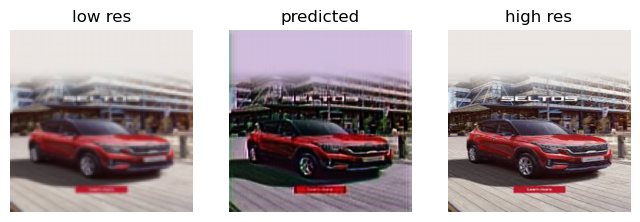

epoch  1 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

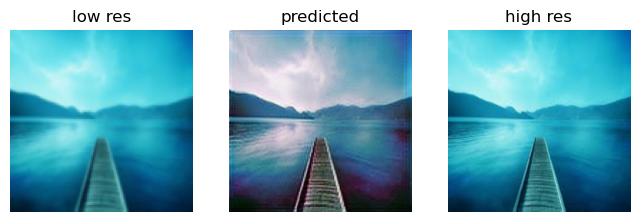

epoch  2 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

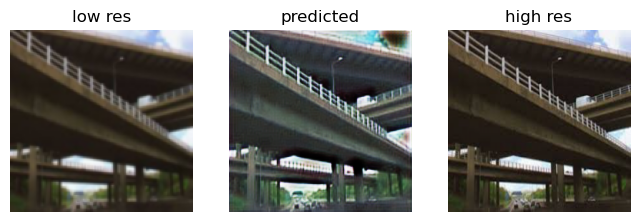

epoch  3 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

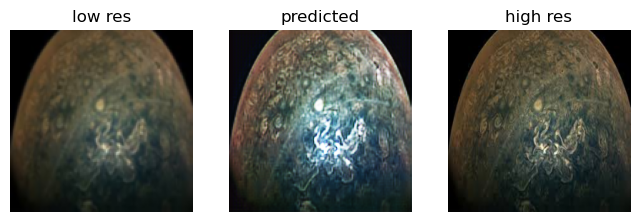

epoch  4 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

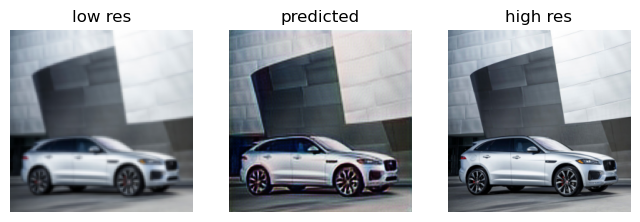

epoch  5 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

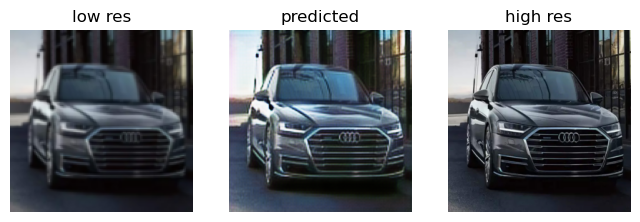

epoch  6 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

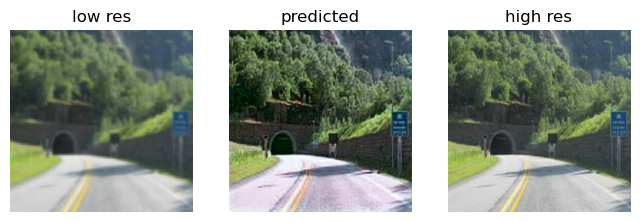

epoch  7 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

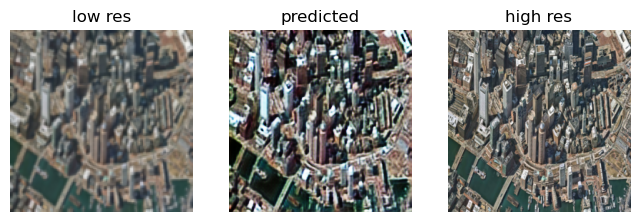

epoch  8 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

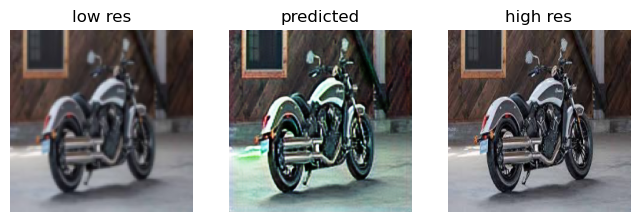

epoch  9 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

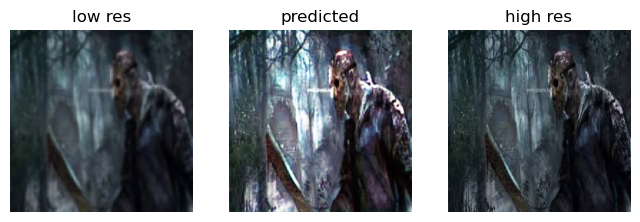

epoch  10 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

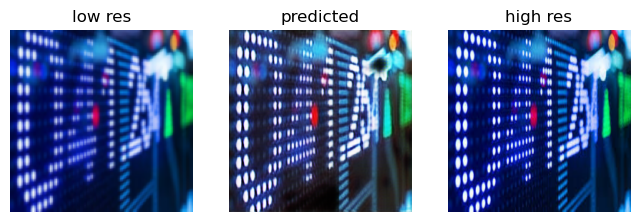

epoch  11 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

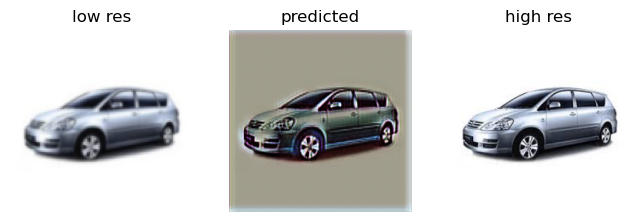

epoch  12 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

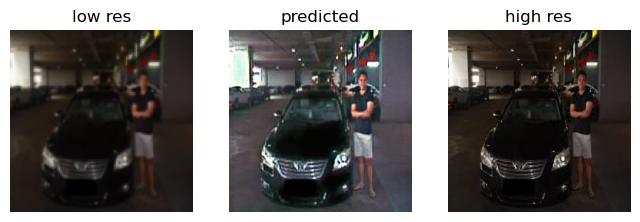

epoch  13 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

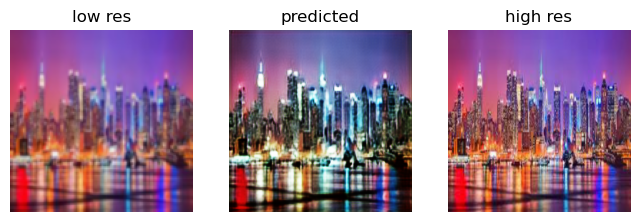

epoch  14 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

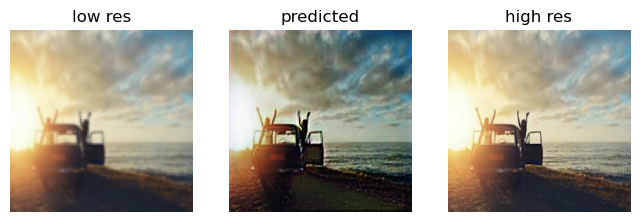

epoch  15 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

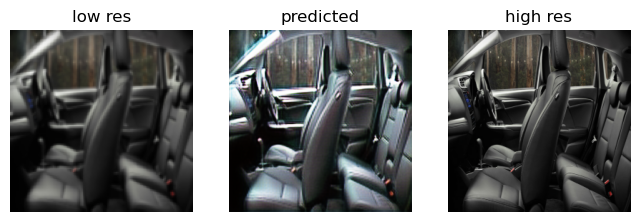

epoch  16 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

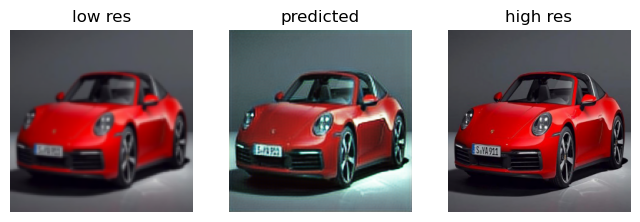

epoch  17 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

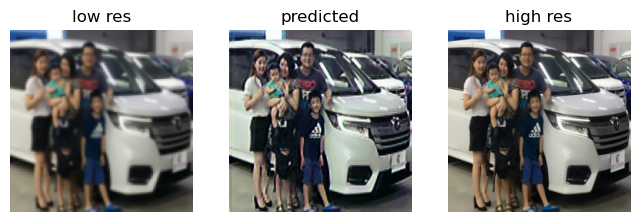

epoch  18 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

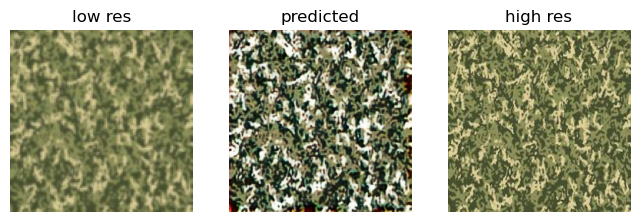

epoch  19 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

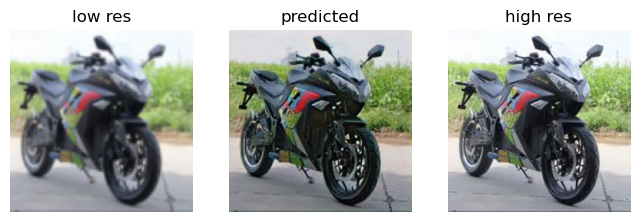

epoch  20 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

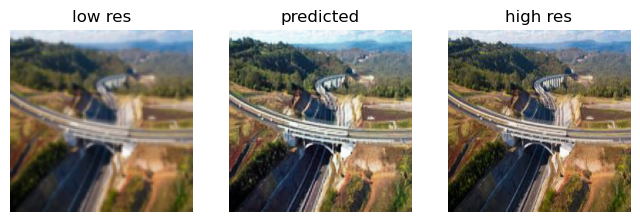

epoch  21 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

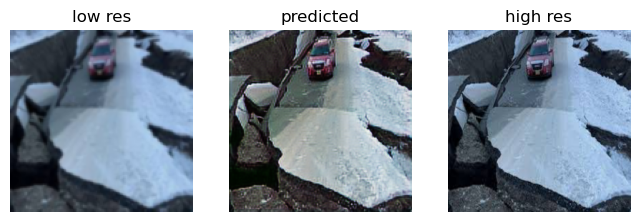

epoch  22 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

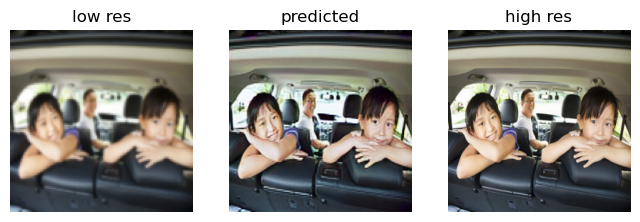

epoch  23 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

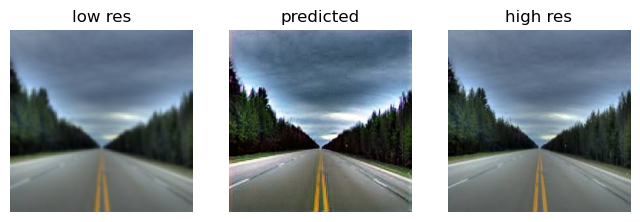

epoch  24 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

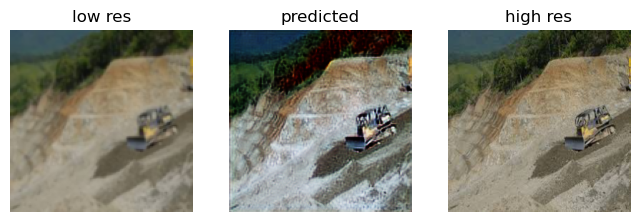

epoch  25 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

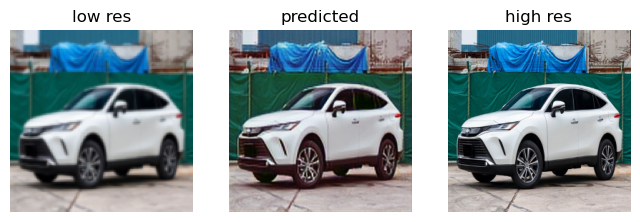

epoch  26 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

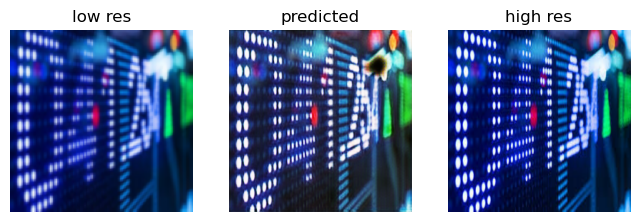

epoch  27 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

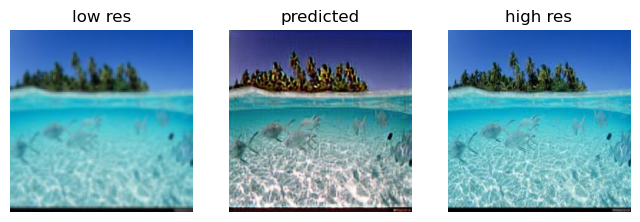

epoch  28 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

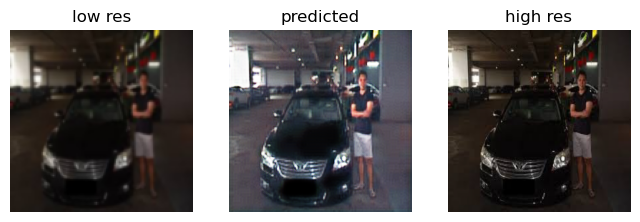

epoch  29 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

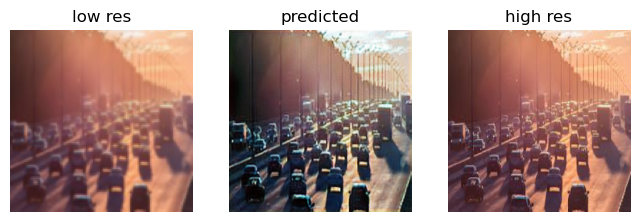

epoch  30 / 30


  0%|          | 0/43 [00:00<?, ?it/s]

In [141]:
d_losses = []
g_losses = []
for epoch in range(epochs):
     plot_examples(gen)
     print("epoch ", epoch+1, "/", epochs)
     gen_loss, disc_loss = train_fn(train_loader, disc, gen, opt_gen, opt_disc, mse, bce, vgg_loss)
     # train discriminator and generator and update losses
     d_losses.append(disc_loss)
     g_losses.append(gen_loss)

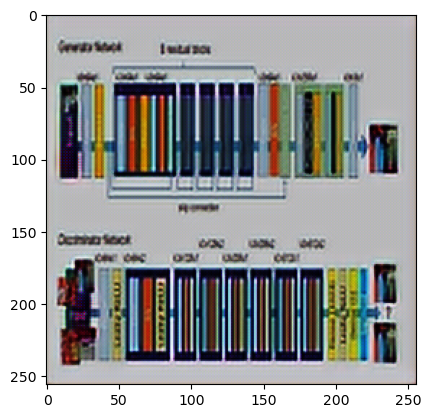

In [148]:
#dataset_test = ImageDataset(root_dir="./my_test/")
img = "./my_test/image_1.png"
img = np.array(Image.open(img))
img = img[:, :, :3]
#test_loader = DataLoader(dataset_test, batch_size=16, num_workers=0)
img = transform_low(img)

loader = DataLoader(img)

with torch.no_grad():  # Отключаем градиенты для ускорения
    upscaled_img = gen(img.to(device).unsqueeze(0))

#upscaled_img = gen(img.to(device).unsqueeze(0))
#upscaled_img = upscaled_img.squeeze(0).cpu().detach().numpy()

imgplot = plt.imshow(upscaled_img.cpu().permute(0,2,3,1)[0])
plt.show()

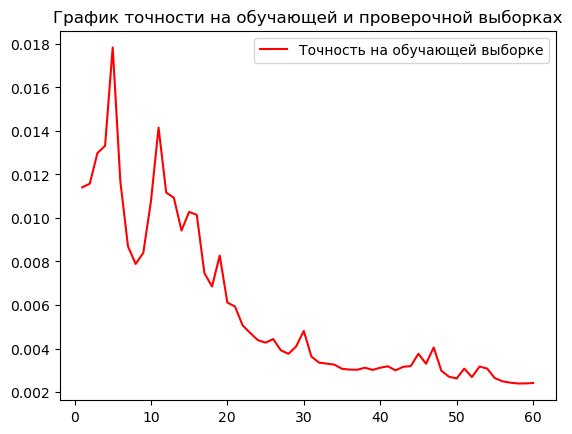

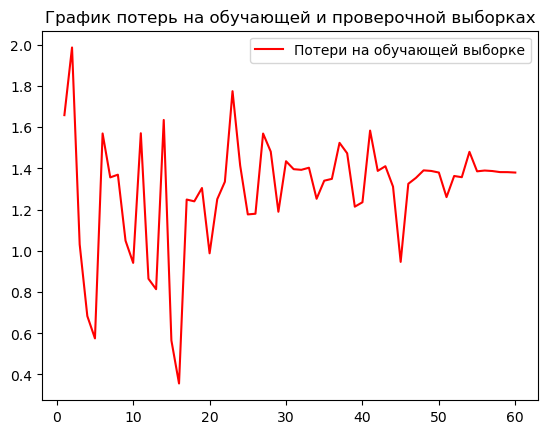

In [152]:
import matplotlib.pyplot as plt           # библиотека для рисования графиков
            # данные об ошибке на обучающей выборке
epochs = range(1, 61)           # массив со значениями для оси абсцисс (Х)
plt.plot(epochs, g_losses, 'r', label='Точность на обучающей выборке')          #  строим график точность на обучающей выборке
plt.title('График точности на обучающей и проверочной выборках')           #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.figure()                                                               #  создаем новую фигуру (полотно для графика)
plt.plot(epochs, d_losses, 'r', label='Потери на обучающей выборке')           #  строим график потерь (ошибки) на обучающей выборке
plt.title('График потерь на обучающей и проверочной выборках')             #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.show() 

###  Enchanced Super-Resolution Generative Adversarial Network (ESRGAN)

## Обучение сетей

In [62]:
upscaler_auto_encoder = create_CAE(width, height, 3)

In [63]:
early_stop = EarlyStopping(monitor='loss', patience=6, restore_best_weights=True)
history = upscaler_auto_encoder.fit(X_train, y_train, batch_size=64, epochs=100, callbacks=[early_stop])

Epoch 1/100
 3/22 ━━━━━━━━━━━━━━━━━━━━ 26s 1s/step - acc: 0.3465 - loss: 0.0703

KeyboardInterrupt: 

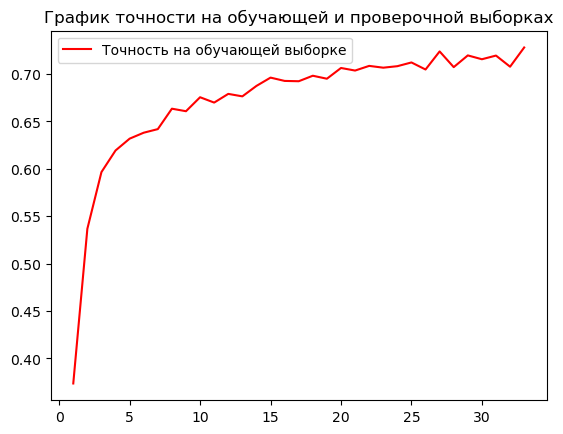

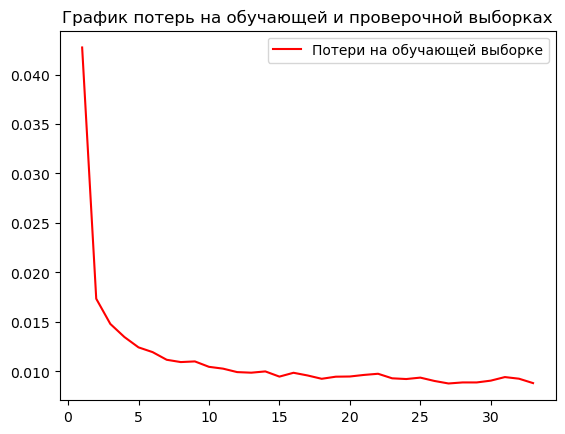

In [46]:
import matplotlib.pyplot as plt           # библиотека для рисования графиков
acc = history.history['acc']              # данные о точности на обучающей выборке
loss = history.history['loss']            # данные об ошибке на обучающей выборке
epochs = range(1, len(acc) + 1)           # массив со значениями для оси абсцисс (Х)
plt.plot(epochs, acc, 'r', label='Точность на обучающей выборке')          #  строим график точность на обучающей выборке
plt.title('График точности на обучающей и проверочной выборках')           #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.figure()                                                               #  создаем новую фигуру (полотно для графика)
plt.plot(epochs, loss, 'r', label='Потери на обучающей выборке')           #  строим график потерь (ошибки) на обучающей выборке
plt.title('График потерь на обучающей и проверочной выборках')             #  заголовок графика
plt.legend()                                                               #  легенда графика
plt.show() 

In [47]:
result = upscaler_auto_encoder.predict(X_test)

6/6 ━━━━━━━━━━━━━━━━━━━━ 1s 179ms/step


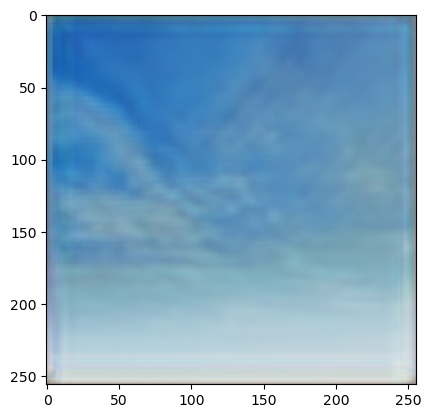

In [48]:
plt.imshow(cv2.cvtColor(result[21], cv2.COLOR_BGR2RGB))

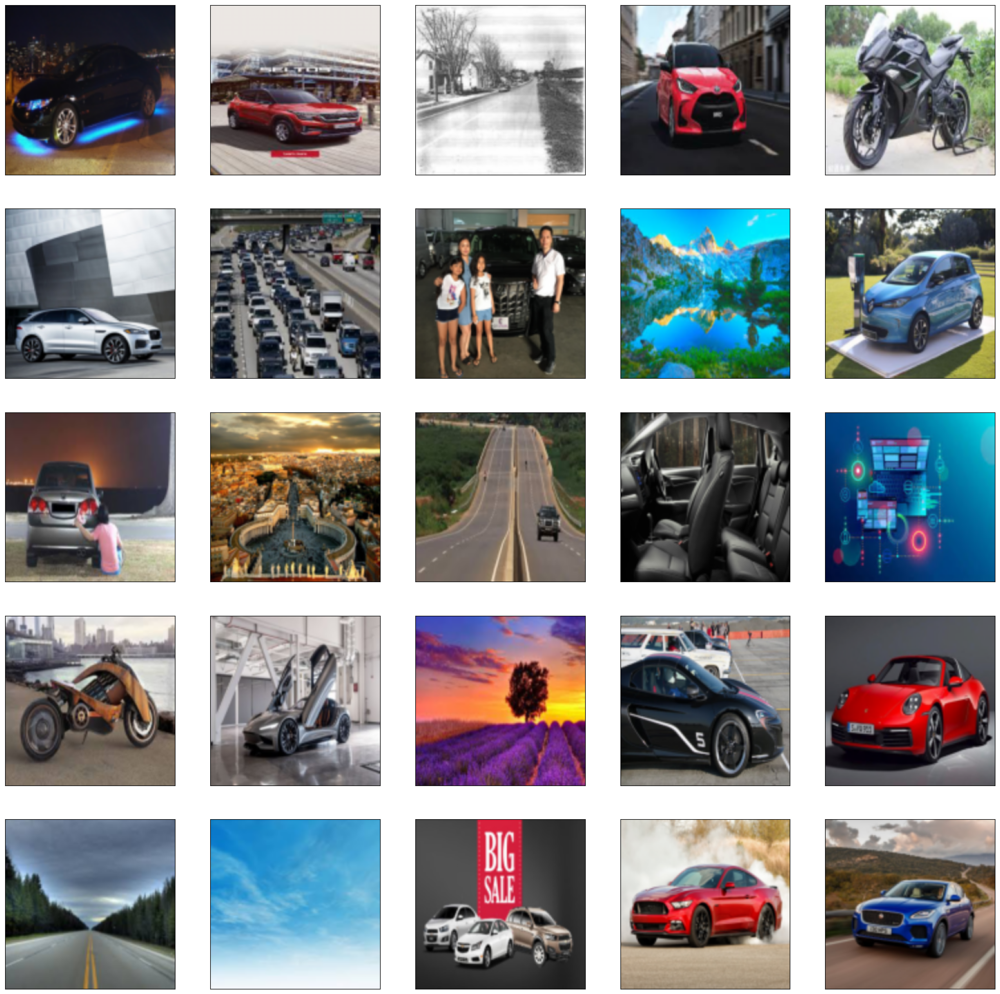

In [49]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(X_test[i].astype('float32'), cv2.COLOR_BGR2RGB))
plt.show()

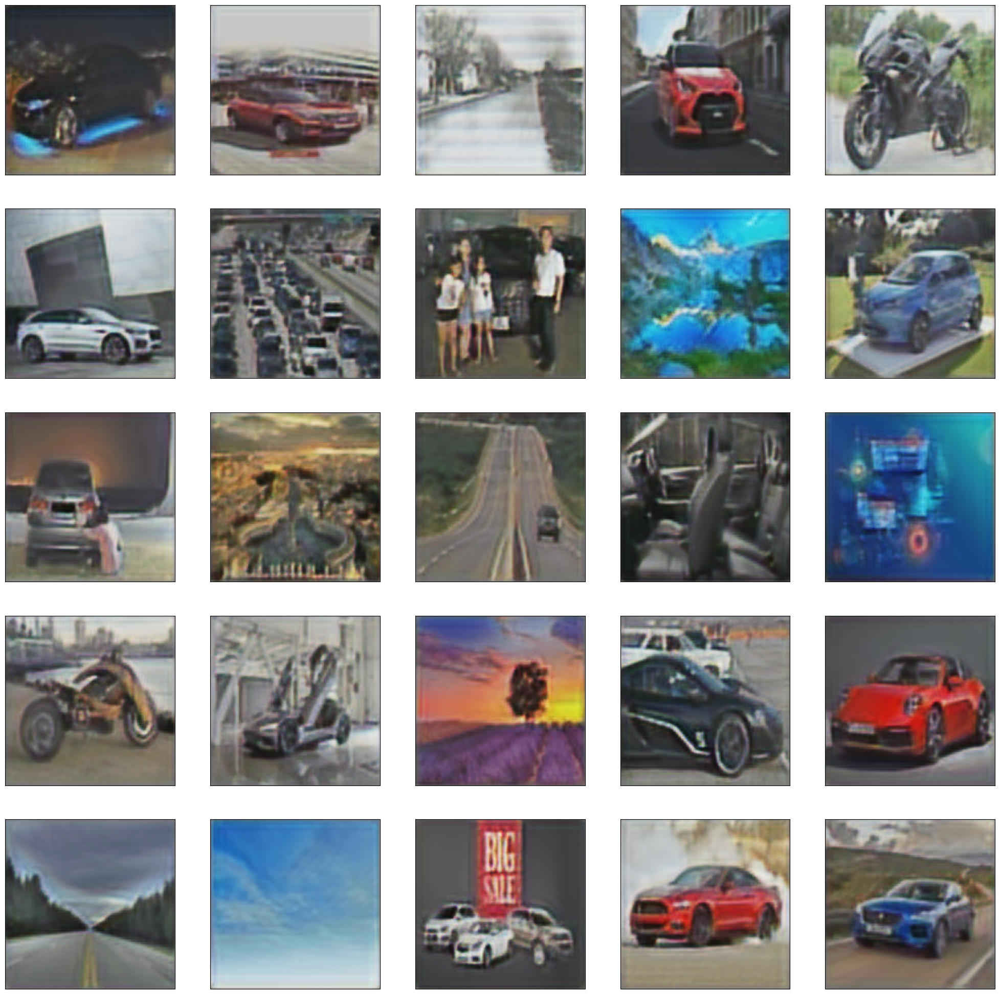

In [50]:
plt.figure(figsize=(25,25))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(result[i], cv2.COLOR_BGR2RGB))
plt.show()